In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display_html 
from datetime import datetime, timedelta
import plotly.express as px

In [8]:
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt
from math import pi


## 1 - Ler os dados

In [19]:
def beggings(row):
    if row["above_400"] == 1:
        return row["CNT"] - 39
    else:
        return 0

def endings(row):
    if row["beggings_CNT"] != 0:
        return row["beggings_CNT"] + 280
    else:
        return 0
    
def inside_blink_period(val, contagens_piscadas):
    if val in contagens_piscadas:
        return 500
    else:
        return 0

def identify_blinks_EEG(EEG):
    EEG["above_400"] = EEG["RAW_EEG"].apply(lambda x: 1 if x >= 200 else 0)
    EEG["below_400"] = EEG["RAW_EEG"].apply(lambda x: 1 if x <= -200 else 0)
    EEG["beggings_CNT"] = EEG.apply(beggings, axis=1)
    EEG["endings_CNT"] = EEG.apply(endings, axis=1)

    tempo_piscadas = EEG[["above_400", "below_400", "beggings_CNT","endings_CNT"]]
    g = tempo_piscadas['above_400'].ne(tempo_piscadas['above_400'].shift()).cumsum() 
    tempo_piscadas = tempo_piscadas.groupby(g).first()[["beggings_CNT","endings_CNT"]].\
        drop_duplicates().reset_index()

    tempo_piscadas['zip_times'] = list(zip(tempo_piscadas.beggings_CNT, tempo_piscadas.endings_CNT))

    contagens_piscadas = []
    for contagem in EEG["CNT"]:
        # para cada contagem dos dados
        for i in tempo_piscadas.zip_times.tolist():
            # para cada possibilidade de estar entre os valores de começo e final de cada piscada
            if i[0] <= contagem <= i[1]:
                # salvar em lista os valores de CNT entre os intervalos
                contagens_piscadas.append(contagem)
            else:
                pass
        
    EEG["potential_blinks_EEG"] = EEG["CNT"].apply(lambda x: inside_blink_period(x, contagens_piscadas))
    EEG = EEG.rename(columns={"CNT":"CNT_EEG"})
    return EEG

    

In [20]:
def matlab_time_to_date(matlab_time):
    return (datetime.fromordinal(int(matlab_time)) + timedelta(days=matlab_time%1) - timedelta(days = 366)).strftime("%H:%M:%S")

def get_data():
    EEG = pd.read_csv("/Users/anasouza/Documents/gp3_mindwave_data_collection/dataset/EEG/10_12_22__14_19_piscada_4s.txt", sep="\t").\
        reset_index().drop("Unnamed: 2", axis=1).rename(columns={"TIME":"TIME_MATLAB","index":"CNT"})
    ET = pd.read_csv("/Users/anasouza/Documents/gp3_mindwave_data_collection/dataset/ET/10_12_22__14_19_piscada_4s.txt", sep="\t").\
        reset_index().drop("Unnamed: 6", axis=1).rename(columns={"index":"TIME_MATLAB", "TIME_GP3":"BLINK", "BKID":"BKDUR"})
    EEG["RAW_EEG"] = EEG["RAW_EEG"].astype(int)
    ET["BLINK"] = ET["BLINK"].astype(int)
    ET["BLINK"] = np.where(ET["USER"] == "NO_DATA", np.nan, ET["BLINK"])
    ET["BLINK"] = ET["BLINK"].fillna(method = 'ffill')
    ET["current_time"] = ET["TIME_MATLAB"].apply(matlab_time_to_date)
    EEG["current_time"] = EEG["TIME_MATLAB"].apply(matlab_time_to_date)
    ET["potential_blinks_ET"] = np.where(ET["BLINK"] != 0, 500, 0)
    ET = ET.reset_index().rename(columns={"index":"CNT_ET"})
    EEG = identify_blinks_EEG(EEG)
    return ET, EEG

In [21]:
ET, EEG = get_data()

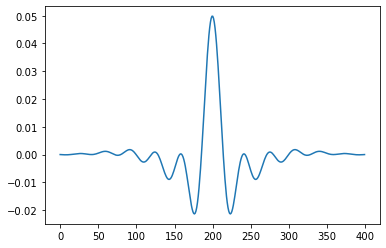

In [22]:
filter = signal.firwin(400, [0.01, 0.06], pass_zero=False)
plt.plot(filter)
plt.show()

In [23]:
y2 = signal.convolve(EEG["RAW_EEG"], filter, mode='same')
EEG["filtered_EEG"] = y2

In [24]:
df1_styler = EEG[:5].style.set_table_attributes("style='display:inline'").set_caption('EEG dataset')
df2_styler = ET[:5].style.set_table_attributes("style='display:inline'").set_caption('ET dataset')

display_html(df1_styler._repr_html_() + "\t" + df2_styler._repr_html_(), raw=True)

,CNT_EEG,TIME_MATLAB,RAW_EEG,current_time,above_400,below_400,beggings_CNT,endings_CNT,potential_blinks_EEG,filtered_EEG
0,0,738865.597100,112,14:19:49,0,0,0,0,500,14.609346
1,1,738865.597100,107,14:19:49,0,0,0,0,0,19.573176
2,2,738865.597100,106,14:19:49,0,0,0,0,0,24.359659
3,3,738865.597100,104,14:19:49,0,0,0,0,0,28.897773
4,4,738865.597100,102,14:19:49,0,0,0,0,0,33.121324
,CNT_ET,TIME_MATLAB,TIME,CNT,BLINK,BKDUR,BKPMIN,USER,current_time,potential_blinks_ET
0,0,738865.597100,34618,588.799440,0.000000,0.000000,11,TERMINAL2_MESSAGE,14:19:49,0
1,1,738865.597100,34619,588.816040,0.000000,0.000000,11,TERMINAL2_MESSAGE,14:19:49,0
2,2,738865.597100,34620,588.832280,0.000000,0.000000,11,TERMINAL2_MESSAGE,14:19:49,0
3,3,738865.597100,34621,588.848690,0.000000,0.000000,11,TERMINAL2_MESSAGE,14:19:49,0


In [29]:
fig = px.line(EEG, x='CNT_EEG', y=["filtered_EEG"])
#fig.add_hrect(y0=200, y1=-200, line_width=0, fillcolor="red", opacity=0.2)
fig.show()

In [26]:
EEG.shape

(52665, 10)

In [27]:
fig = px.line(EEG, x='CNT_EEG', y=["filtered_EEG", "potential_blinks_EEG"])
fig.show()

In [28]:
fig = px.line(ET, x='CNT_ET', y=["potential_blinks_ET"])
fig.show()

Quero expandir o dataset de ET, de forma que ele passe a ter um numero de linhas igual ao do dataset de EEG.
- Criar um vetor de elementos igualmente espaçados entre o mínimo e máximo do valor do dataset de EEG.
- Como só teremos valores int no CNT, criar varios valores INT que se repetem

In [10]:
vetor_cnt_EEG = np.linspace(ET.CNT_ET.min(), ET.CNT_ET.max(), EEG.shape[0])

In [11]:
vetor_cnt_EEG = vetor_cnt_EEG.astype(int)

In [12]:
len(vetor_cnt_EEG) == EEG.shape[0]

True

In [13]:
df_vetor_CNT = pd.DataFrame(vetor_cnt_EEG)

In [14]:
df_vetor_CNT.columns = ["CNT_EXP"]
df_vetor_CNT

,CNT_EXP
0,0
1,0
2,0
3,0
4,1
...,...
52660,13767
52661,13768
52662,13768
52663,13768


In [15]:
EXP_ET = pd.merge(ET, df_vetor_CNT, left_on="CNT_ET", right_on="CNT_EXP", how="outer")

In [16]:
EXP_ET.shape[0], ET.shape[0]

(52665, 13770)

In [17]:
65725 / 13770

4.773057371096587

In [18]:
EXP_ET.isnull().sum()

CNT_ET                 0
TIME_MATLAB            0
TIME                   0
CNT                    0
BLINK                  0
BKDUR                  0
BKPMIN                 0
USER                   0
current_time           0
potential_blinks_ET    0
CNT_EXP                0
dtype: int64

In [19]:
EXP_ET["CNT_EEG"] = EEG["CNT_EEG"]

In [20]:
fig = px.line(ET, x='CNT_ET', y=["potential_blinks_ET"])
fig.show()

In [21]:
fig = px.line(EEG, x='CNT_EEG', y=["RAW_EEG", "potential_blinks_EEG"])
fig.show()

In [22]:
fig = px.line(EXP_ET, x='CNT_EEG', y=["potential_blinks_ET"])
fig.show()

## Merge

In [23]:
MULTIMODAL_1 = EXP_ET.merge(EEG, on="CNT_EEG")

In [24]:
MULTIMODAL_1

,CNT_ET,TIME_MATLAB_x,TIME,CNT,BLINK,BKDUR,BKPMIN,USER,current_time_x,potential_blinks_ET,CNT_EXP,CNT_EEG,TIME_MATLAB_y,RAW_EEG,current_time_y,above_400,below_400,beggings_CNT,endings_CNT,potential_blinks_EEG
0,0,738865.5971,34618,588.79944,0.0,0.0,11,TERMINAL2_MESSAGE,14:19:49,0,0,0,738865.5971,112,14:19:49,0,0,0,0,500
1,0,738865.5971,34618,588.79944,0.0,0.0,11,TERMINAL2_MESSAGE,14:19:49,0,0,1,738865.5971,107,14:19:49,0,0,0,0,0
2,0,738865.5971,34618,588.79944,0.0,0.0,11,TERMINAL2_MESSAGE,14:19:49,0,0,2,738865.5971,106,14:19:49,0,0,0,0,0
3,0,738865.5971,34618,588.79944,0.0,0.0,11,TERMINAL2_MESSAGE,14:19:49,0,0,3,738865.5971,104,14:19:49,0,0,0,0,0
4,1,738865.5971,34619,588.81604,0.0,0.0,11,TERMINAL2_MESSAGE,14:19:49,0,1,4,738865.5971,102,14:19:49,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52660,13767,738865.5985,0,0.00000,0.0,0.0,0,NO_DATA,14:21:50,0,13767,52660,738865.5985,53,14:21:50,0,0,0,0,0
52661,13768,738865.5985,41534,709.25488,0.0,0.0,24,COLLECTION,14:21:50,0,13768,52661,738865.5985,65,14:21:50,0,0,0,0,0
52662,13768,738865.5985,41534,709.25488,0.0,0.0,24,COLLECTION,14:21:50,0,13768,52662,738865.5985,82,14:21:50,0,0,0,0,0
52663,13768,738865.5985,41534,709.25488,0.0,0.0,24,COLLECTION,14:21:50,0,13768,52663,738865.5985,85,14:21:50,0,0,0,0,0


Não se esquecer que pode haver piscadas não existentes.

In [25]:

MULTIMODAL_1["potential_blinks_ET_neg"] = MULTIMODAL_1["potential_blinks_ET"] * -1
fig = px.line(MULTIMODAL_1, x='CNT_EEG', y=["RAW_EEG", "potential_blinks_EEG", "potential_blinks_ET_neg"])
fig.show()

In [64]:
MULTIMODAL_1_test = MULTIMODAL_1.iloc[33162:39394,:]

In [65]:
MULTIMODAL_1_test["TEST"] = MULTIMODAL_1_test["potential_blinks_ET"] * -1
fig = px.line(MULTIMODAL_1_test, x='CNT_EEG', y=["RAW_EEG", "potential_blinks_EEG", "potential_blinks_ET_neg"])
fig.show()

/var/folders/c7/n7fskkg1029g6xhbfw1vpc8c0000gn/T/ipykernel_27836/1158227246.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



# Shift

In [56]:
shift_increase = -28
MULTIMODAL_1["potential_blinks_ET_neg_shift"] = MULTIMODAL_1["potential_blinks_ET_neg"].shift(shift_increase)
fig = px.line(MULTIMODAL_1, x='CNT_EEG', y=["RAW_EEG", "potential_blinks_EEG", "potential_blinks_ET_neg_shift"])
fig.show()

# Optimization of simultaneos area

In [212]:
EEG_blink_time_series = MULTIMODAL_1[["CNT_EEG", "potential_blinks_EEG"]]
ET_blink_time_series = MULTIMODAL_1[["CNT_EEG", "potential_blinks_ET"]]

In [213]:
# EEG_blink_time_series = EEG_blink_time_series.set_index("CNT_EEG")
# ET_blink_time_series = ET_blink_time_series.set_index("CNT_EEG")

# Correlação de Pearson

In [218]:
def calc_correlation(actual, predic):
    a_diff = actual - np.mean(actual)[1]
    p_diff = predic - np.mean(predic)[1]
    numerator = np.sum(a_diff * p_diff)
    denominator = np.sqrt(np.sum(a_diff ** 2)) * np.sqrt(np.sum(p_diff ** 2))
    return numerator / denominator

In [217]:
np.mean(EEG_blink_time_series)[1]

105.94322605145733

In [219]:
calc_correlation(EEG_blink_time_series, ET_blink_time_series)

CNT_EEG                 1.0
potential_blinks_EEG    NaN
potential_blinks_ET     NaN
dtype: float64

## Cross Correlation

y2 is -1.0152583249261173 behind y1


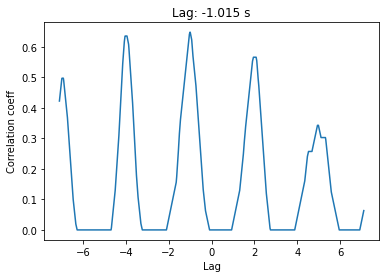

In [67]:
import matplotlib.pyplot as plt
from scipy import signal
import numpy as np


def lag_finder(y1, y2, sr):
    n = len(y1)

    corr = signal.correlate(y2, y1, mode='same') / np.sqrt(signal.correlate(y1, y1, mode='same')[int(n/2)] * signal.correlate(y2, y2, mode='same')[int(n/2)])

    delay_arr = np.linspace(-0.5*n/sr, 0.5*n/sr, n)
    delay = delay_arr[np.argmax(corr)]
    print('y2 is ' + str(delay) + ' behind y1')

    plt.figure()
    plt.plot(delay_arr, corr)
    plt.title('Lag: ' + str(np.round(delay, 3)) + ' s')
    plt.xlabel('Lag')
    plt.ylabel('Correlation coeff')
    plt.show()

# Sine sample with some noise and copy to y1 and y2 with a 1-second lag
sr = EEG.shape[0]/120

y1 = MULTIMODAL_1_test["potential_blinks_EEG"]
y2 = MULTIMODAL_1_test["potential_blinks_ET"]

lag_finder(y1, y2, sr)

In [34]:
y1

0        500
1          0
2          0
3          0
4          0
        ... 
52660      0
52661      0
52662      0
52663      0
52664      0
Name: potential_blinks_EEG, Length: 52665, dtype: int64